In [1]:
! nvidia-smi

Mon May  8 09:28:41 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   76C    P0    69W /  70W |   1577MiB / 15360MiB |     74%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla T4            Off  | 00000000:00:05.0 Off |                    0 |
| N/A   

In [2]:
from spellbook.parallel import get_experiment_name

from train_pipeline import train, _train_seed

import os
from hydra import initialize, initialize_config_module, initialize_config_dir, compose
from hydra.utils import instantiate
from omegaconf import OmegaConf


def load_cfg(overrides=()):
    # with initialize_config_dir(config_dir="/app/notebooks/draft_02/conf"):
    with initialize(version_base=None, config_path="./conf"):
        cfg = compose(config_name='config', overrides=list(overrides))
        return cfg

from IPython.display import clear_output



from spellbook.parallel import _parallel_model_tag
from spellbook import count_parameters

    

def get_experiment_name(cfg):
    nparams=count_parameters(instantiate(cfg.model, out_features=3))
    return f'{cfg.logging.experiment_name}__{_parallel_model_tag(cfg)}__nparams={nparams}'


+--------------------------------+------------+
|            Modules             | Parameters |
+--------------------------------+------------+
| networks.0.net.0.linear.weight |   16384    |
|  networks.0.net.0.linear.bias  |    128     |
| networks.0.net.1.linear.weight |    2048    |
|  networks.0.net.1.linear.bias  |     64     |
|    networks.0.net.2.weight     |     48     |
|     networks.0.net.2.bias      |     3      |
+--------------------------------+------------+
Total Trainable Params: 18675
Setting seed to 0


mse,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▂▃▃▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇███████████████████
step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2034
total_params,18675


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
model:
  _target_: spellbook.parallel.ParallelSplitNet
  encoding_size: 64
  model_configs:
  - hidden_layers:
    - 32
    - 16
    m: 10.0
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: splitnet__[128],32,16__nparams=18675__true10
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+--------------------------------+------------+
|            Modules             | Parameters |
+--------------------------------+------------+
| networks.0.net.0.linear.weight |   16384    |
|  networks.0.net.0.linear.bias  |    128     |
| networks.0.net.1.linear.weight |    2048    |


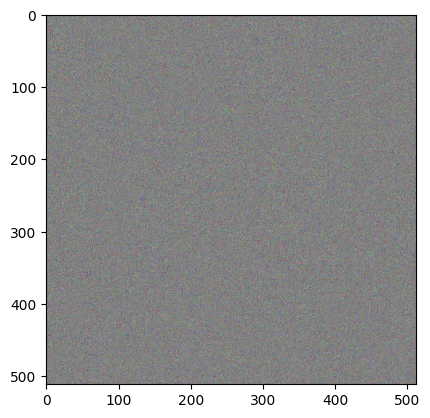

Step 500, Total loss 0.271239


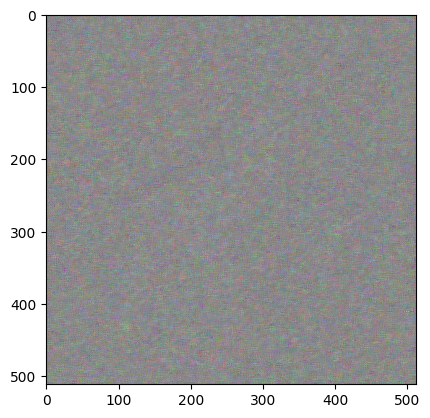

Step 1000, Total loss 0.091375


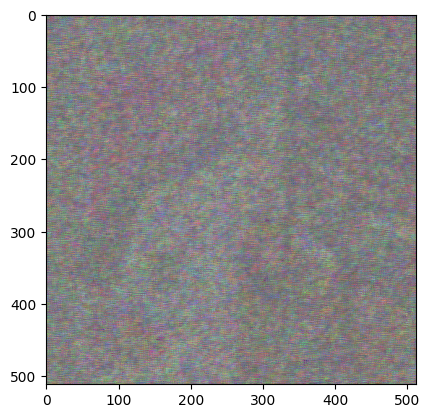

Step 1500, Total loss 0.064636


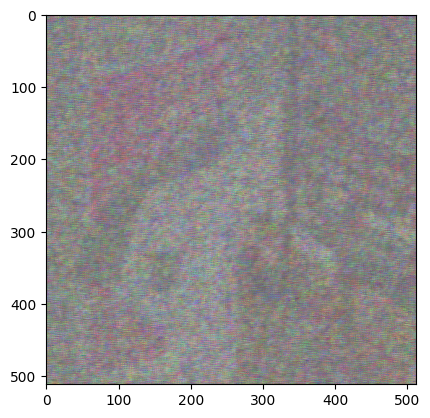

Step 2000, Total loss 0.050203


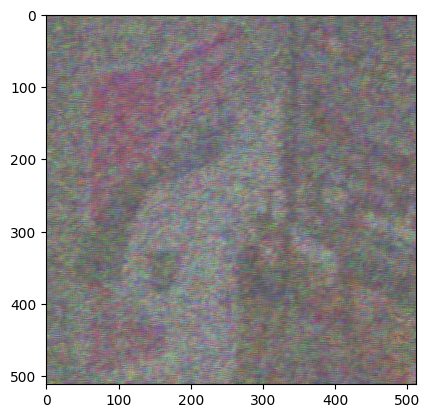

Step 2500, Total loss 0.041468


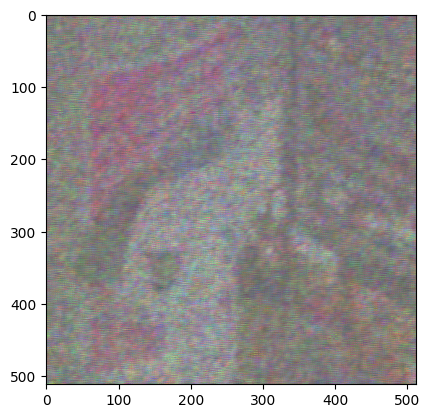

In [17]:
cfg = load_cfg(overrides=[
    "+exp=04_parallel",
    "model.model_configs=[{hidden_layers: [32, 16]}]",
    "+device=cuda:0",
])

cfg.model.model_configs[0] = {'hidden_layers': [32, 16],
   'm': 10.0,
   # 'omegas': [[2.689339192708333,
   #   16.50197957356771,
   #   6.805110168457031,
   #   6.799144490559896],
   #  [8.467052205403645,
   #   42.76984456380208,
   #   12.20421142578125,
   #   14.096522013346354]]
                }

cfg.logging.experiment_name = get_experiment_name(cfg) + '__true10'
cfg.random_seed = [0]

# print(OmegaConf.to_yaml(cfg))
train(cfg)

'splitnet__[128],32,16__nparams=18675'

In [ ]:
break

+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |     64     |
|     net.2.weight    |    192     |
|      net.2.bias     |     3      |
+---------------------+------------+
Total Trainable Params: 4547
Setting seed to 0


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: kilianovski. Use `wandb login --relogin` to force relogin


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 1
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=1_h=64__nparams=4547
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |    

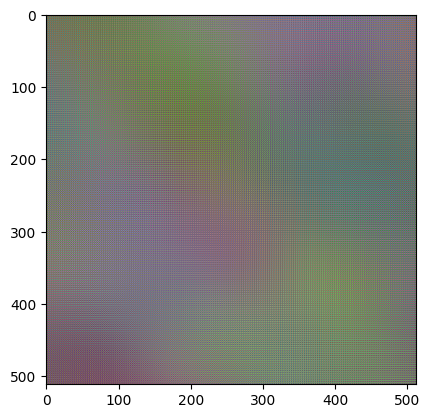

Step 500, Total loss 0.027412


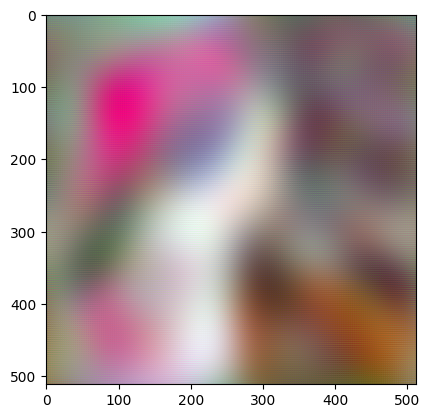

Step 1000, Total loss 0.024052


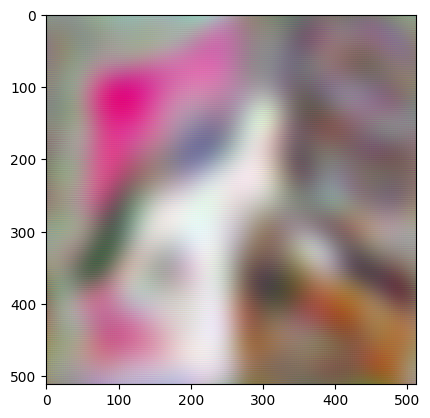

Step 1500, Total loss 0.022525


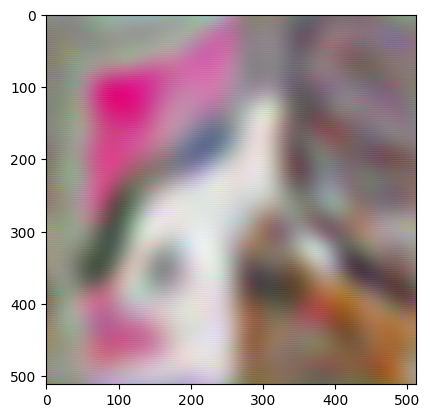

Step 2000, Total loss 0.021661


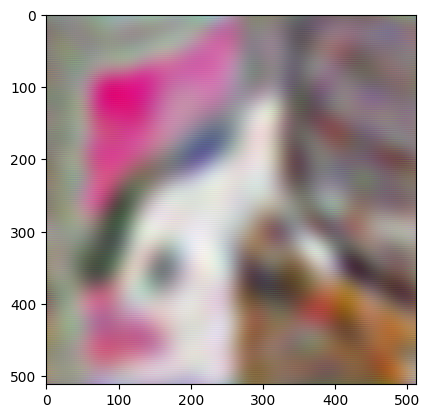

Step 2500, Total loss 0.020952


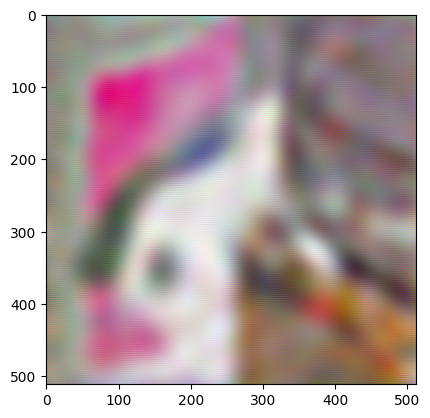

Setting seed to 1


mse,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▅▆▇▇▇▇▇▇▇▇▇████████████████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,4547


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 1
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=1_h=64__nparams=4547
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |    

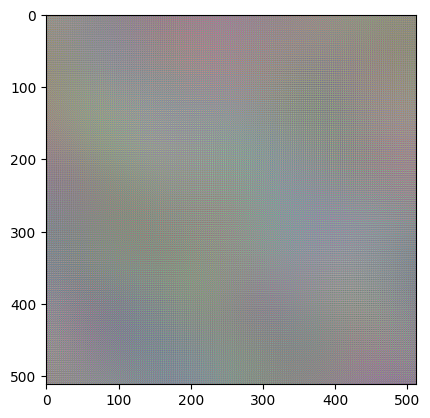

Step 500, Total loss 0.026757


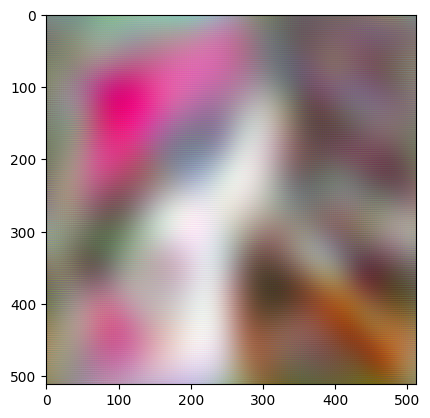

Step 1000, Total loss 0.023561


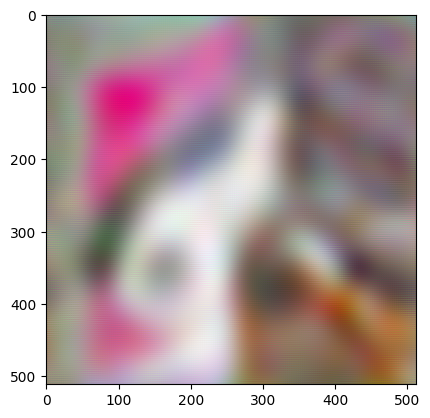

Step 1500, Total loss 0.022110


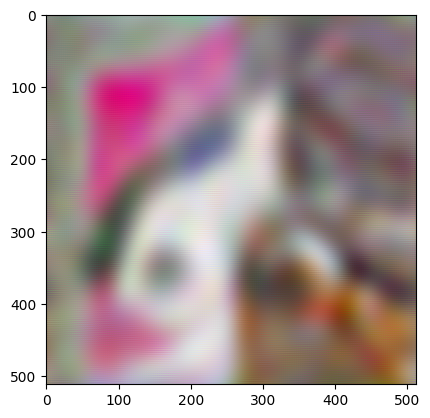

Step 2000, Total loss 0.021193


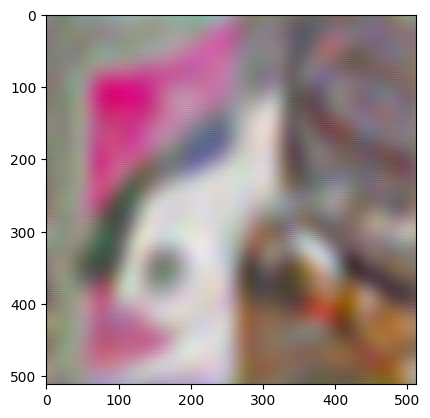

Step 2500, Total loss 0.020495


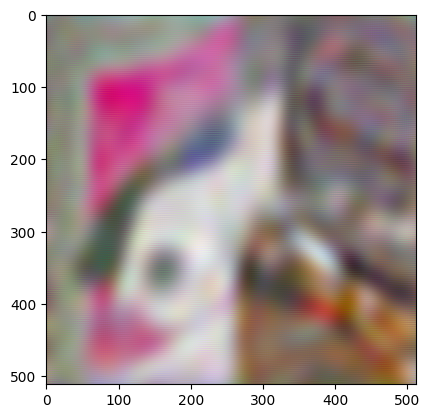

Setting seed to 2


mse,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▅▆▇▇▇▇▇▇▇▇▇████████████████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,4547


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 1
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=1_h=64__nparams=4547
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |    

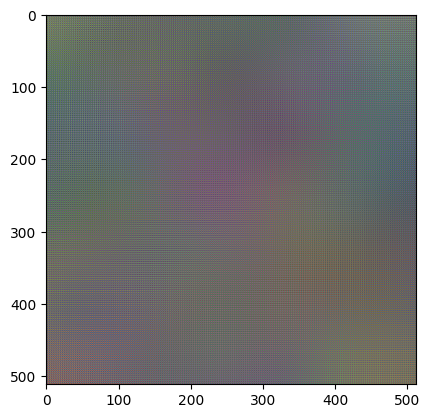

Step 500, Total loss 0.026746


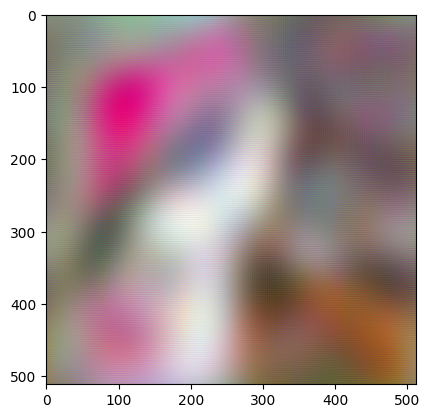

Step 1000, Total loss 0.023872


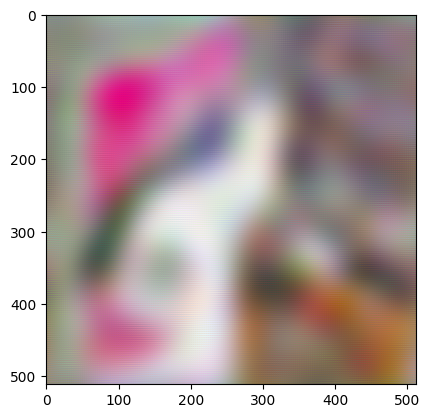

Step 1500, Total loss 0.022507


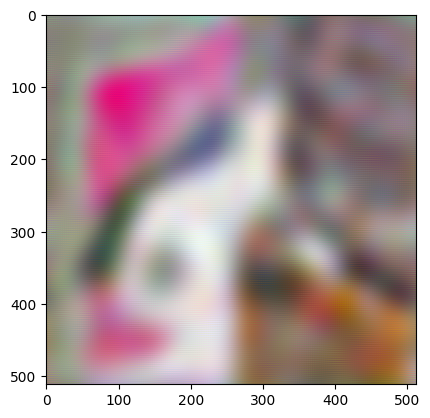

Step 2000, Total loss 0.021581


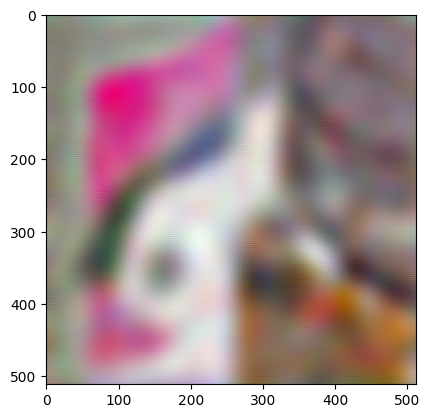

Step 2500, Total loss 0.020857


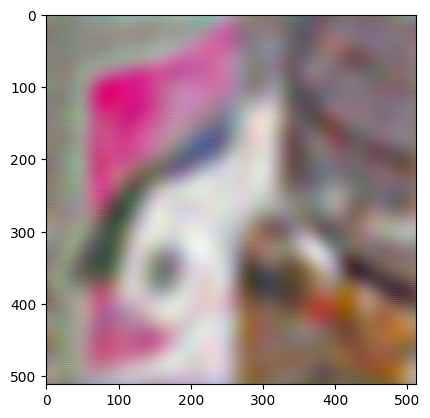

+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |     64     |
| net.2.linear.weight |    4096    |
|  net.2.linear.bias  |     64     |
|     net.3.weight    |    192     |
|      net.3.bias     |     3      |
+---------------------+------------+
Total Trainable Params: 8707
Setting seed to 0


mse,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▆▇▇▇▇▇▇▇██████████████████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,4547


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 2
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=2_h=64__nparams=8707
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |    

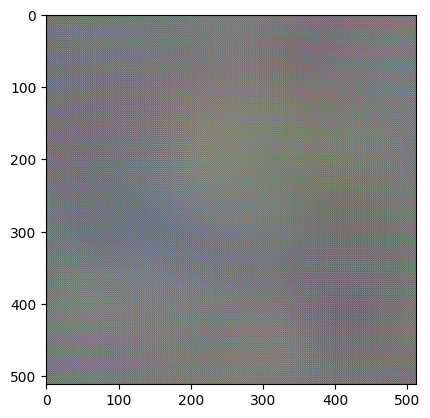

Step 500, Total loss 0.023729


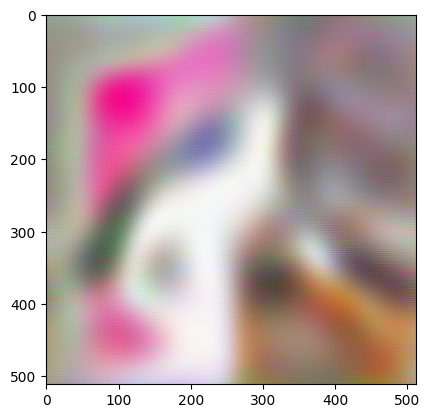

Step 1000, Total loss 0.019814


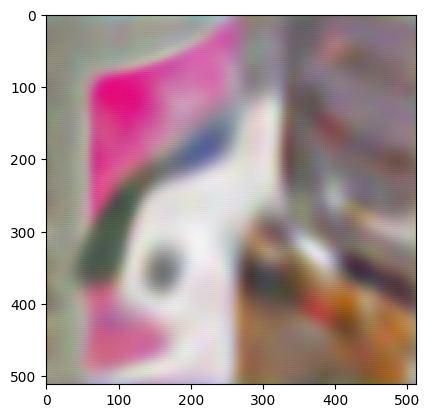

Step 1500, Total loss 0.017303


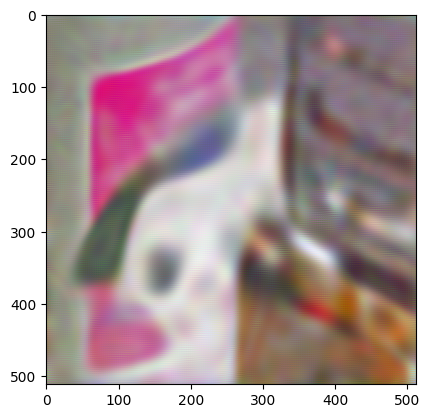

Step 2000, Total loss 0.015676


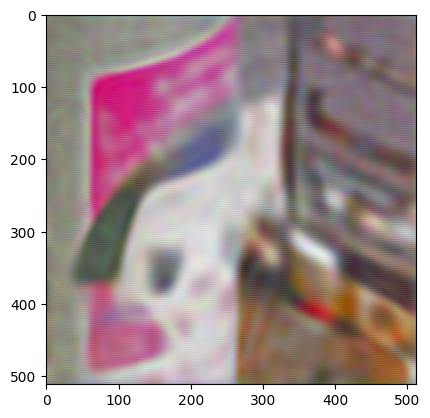

Step 2500, Total loss 0.014606


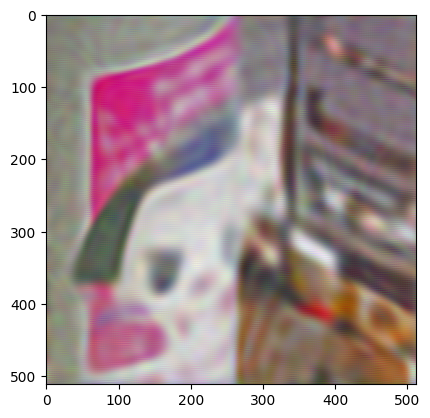

Setting seed to 1


mse,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,8707


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 2
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=2_h=64__nparams=8707
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |    

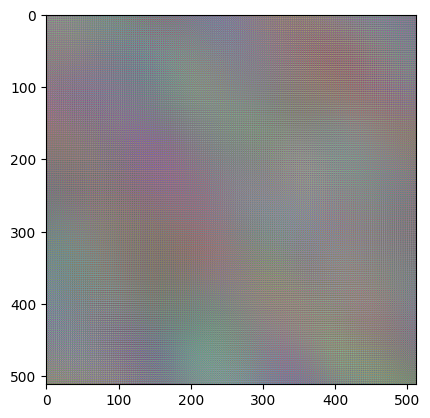

Step 500, Total loss 0.023410


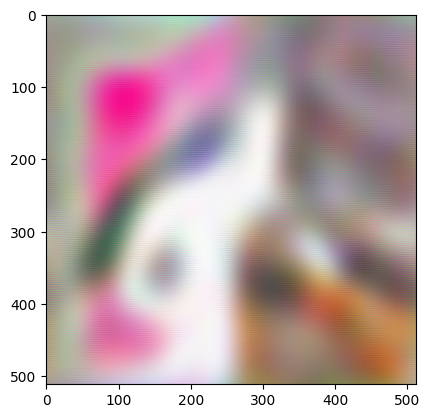

Step 1000, Total loss 0.019913


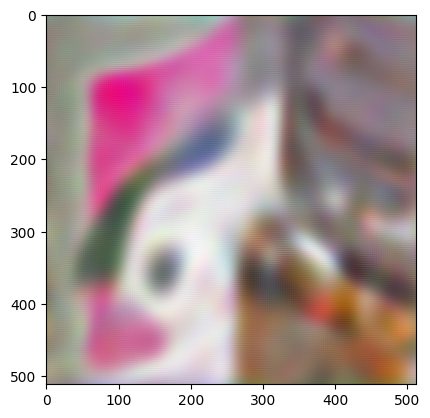

Step 1500, Total loss 0.017329


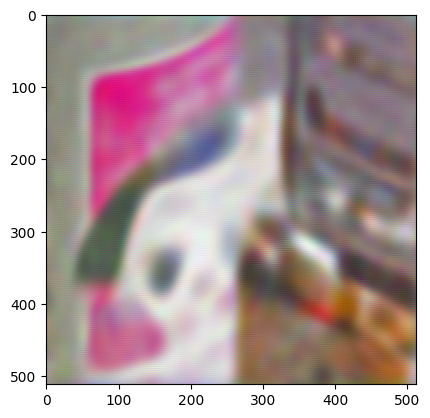

Step 2000, Total loss 0.015615


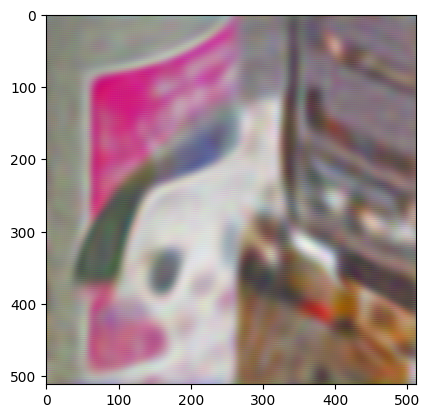

Step 2500, Total loss 0.014525


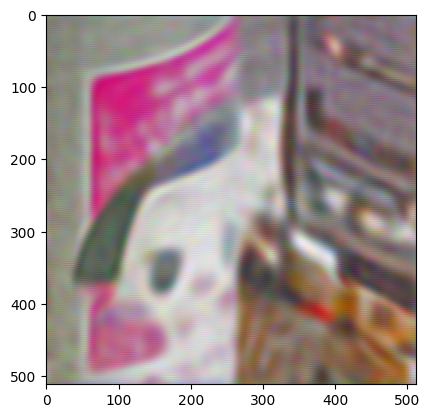

Setting seed to 2


mse,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,8707


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 2
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=2_h=64__nparams=8707
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |    

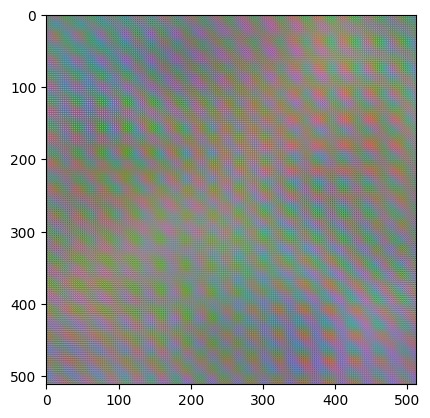

Step 500, Total loss 0.023296


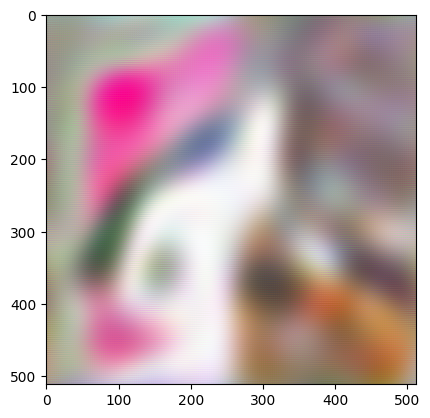

Step 1000, Total loss 0.020006


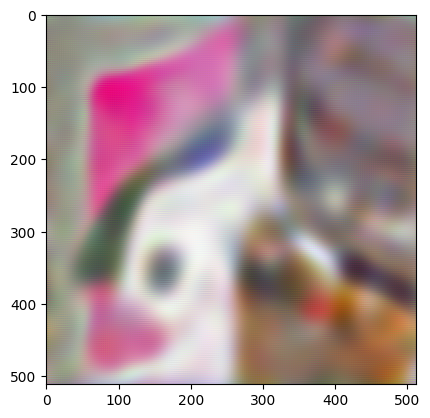

Step 1500, Total loss 0.017397


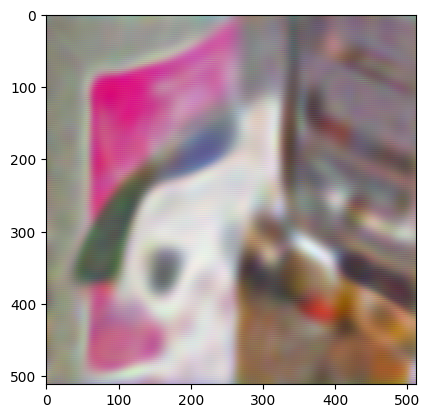

Step 2000, Total loss 0.015540


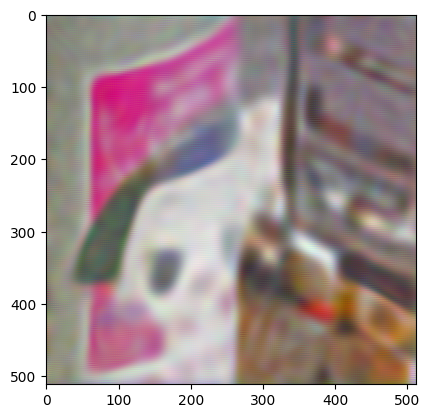

Step 2500, Total loss 0.014427


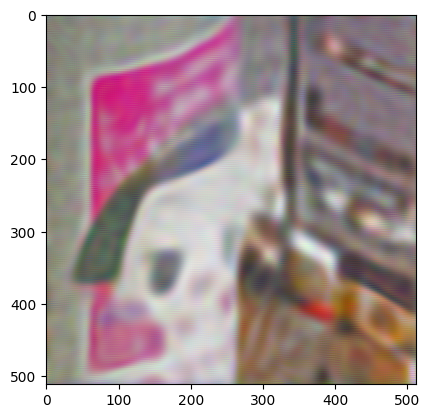

+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |     64     |
| net.2.linear.weight |    4096    |
|  net.2.linear.bias  |     64     |
| net.3.linear.weight |    4096    |
|  net.3.linear.bias  |     64     |
|     net.4.weight    |    192     |
|      net.4.bias     |     3      |
+---------------------+------------+
Total Trainable Params: 12867
Setting seed to 0


mse,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,8707


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 3
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=3_h=64__nparams=12867
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |   

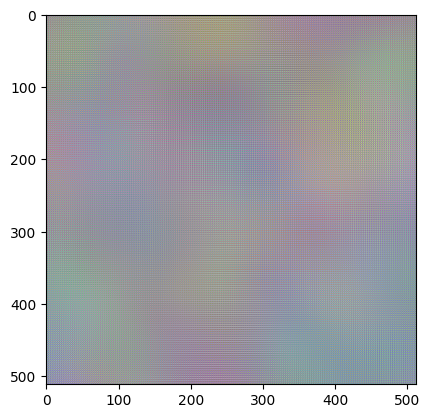

Step 500, Total loss 0.020560


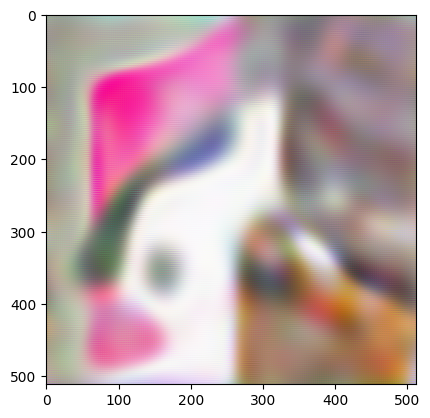

Step 1000, Total loss 0.015746


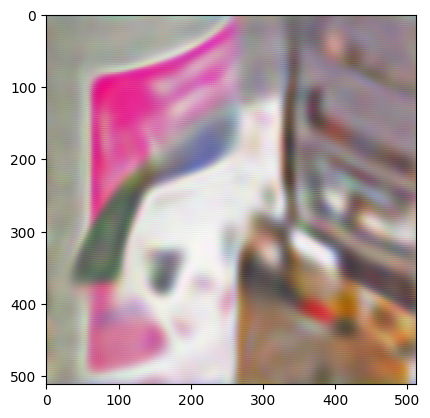

Step 1500, Total loss 0.013702


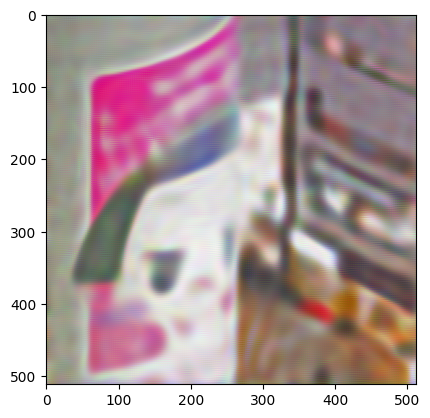

Step 2000, Total loss 0.012627


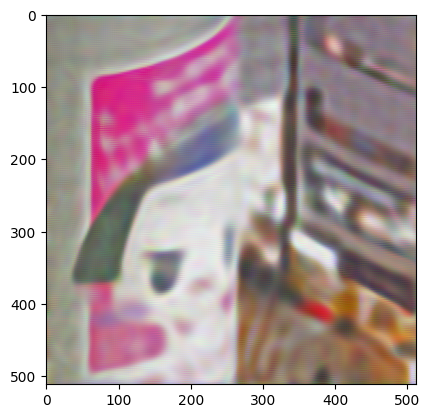

Step 2500, Total loss 0.011902


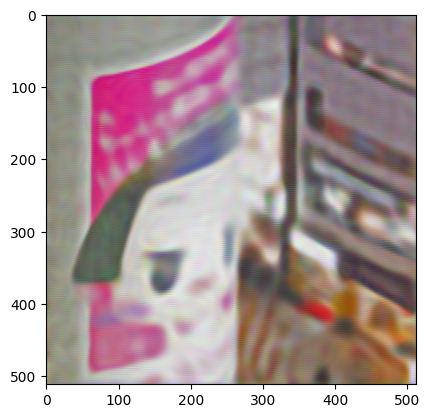

Setting seed to 1


mse,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,12867


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 3
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=3_h=64__nparams=12867
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |   

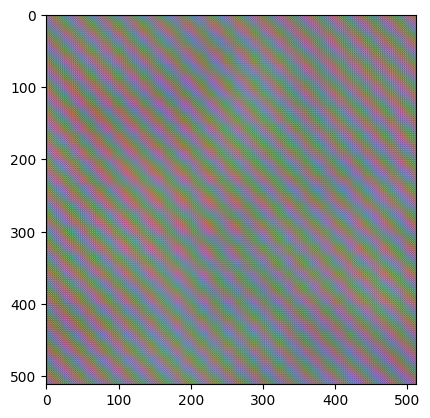

Step 500, Total loss 0.020542


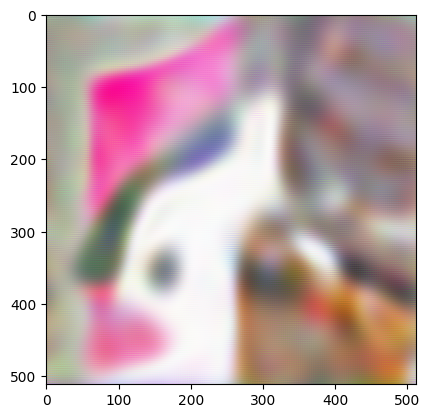

Step 1000, Total loss 0.015559


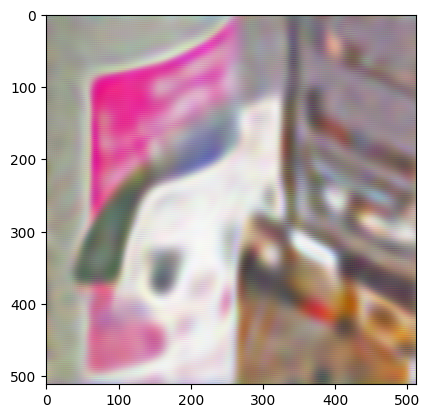

Step 1500, Total loss 0.013434


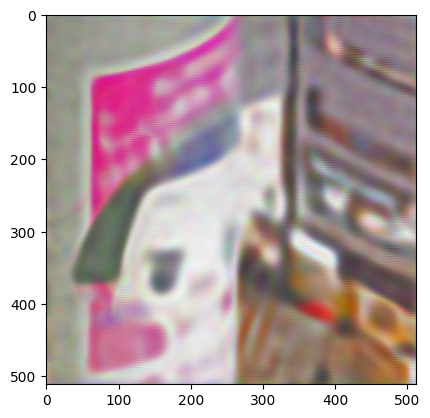

Step 2000, Total loss 0.012321


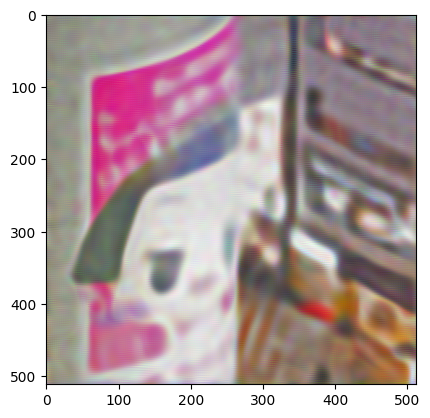

Step 2500, Total loss 0.011590


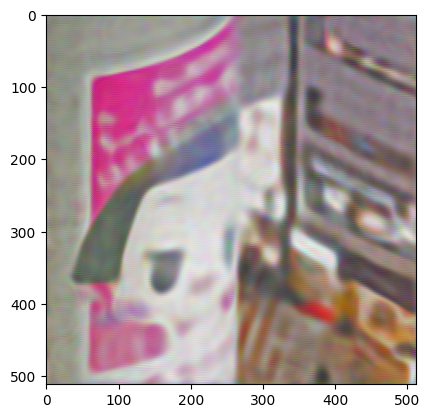

Setting seed to 2


mse,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇█████████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,12867


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 3
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=3_h=64__nparams=12867
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |   

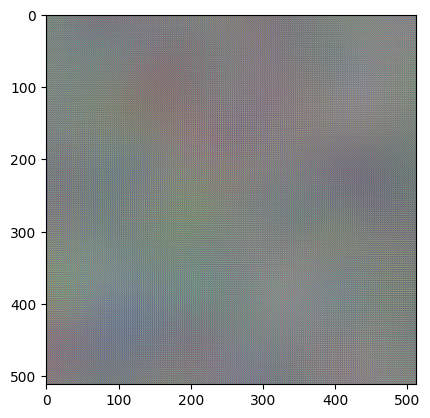

Step 500, Total loss 0.020396


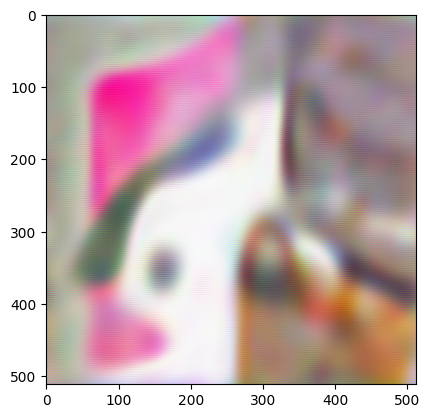

Step 1000, Total loss 0.015529


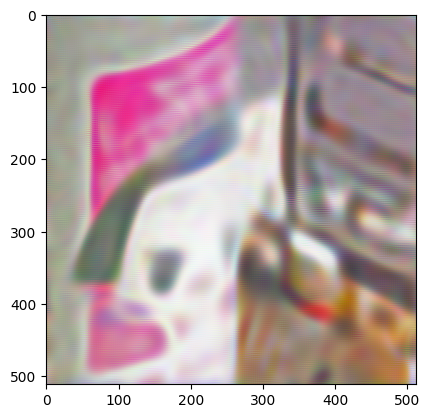

Step 1500, Total loss 0.013389


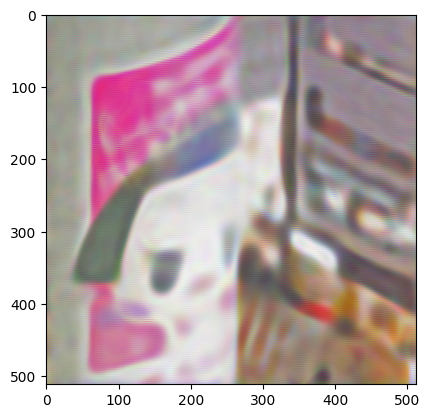

Step 2000, Total loss 0.012280


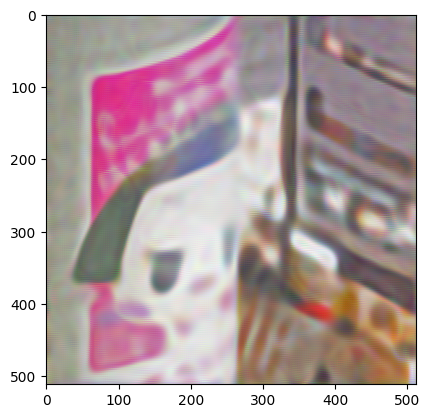

Step 2500, Total loss 0.011648


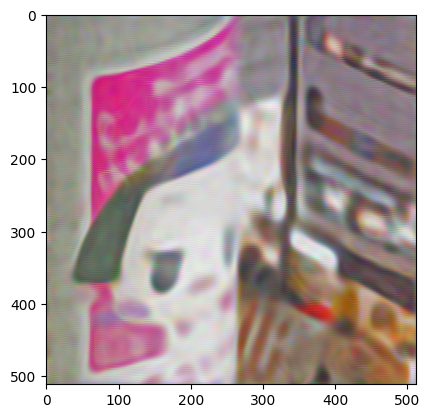

+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |     64     |
| net.2.linear.weight |    4096    |
|  net.2.linear.bias  |     64     |
| net.3.linear.weight |    4096    |
|  net.3.linear.bias  |     64     |
| net.4.linear.weight |    4096    |
|  net.4.linear.bias  |     64     |
|     net.5.weight    |    192     |
|      net.5.bias     |     3      |
+---------------------+------------+
Total Trainable Params: 17027
Setting seed to 0


mse,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
psnr,▁▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇█████████████████████
step,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
total_params,▁
step,2999
total_params,12867


********************************************************************************


image: tokyo512.png
image_dir: ../../data
image_W: 512
use_wandb: true
is_debug: false
total_steps: 3000
random_seed:
- 0
- 1
- 2
model:
  _target_: spellbook.siren.model.Siren
  in_features: 2
  out_features: none
  hidden_features: 64
  hidden_layers: 4
  init_c: 6
  first_layer_init_c: 1
  outermost_linear: true
logging:
  logger:
    _target_: spellbook.logging.wandb.WandbLogger
    project: 01_splitnet__${image}
  steps_till_summary: 500
  experiment_name: siren_nh=4_h=64__nparams=17027
optimizer:
  _target_: torch.optim.AdamW
  weight_decay: 0.0
  lr: 0.0001
device: cuda:0


********************************************************************************
+---------------------+------------+
|       Modules       | Parameters |
+---------------------+------------+
| net.0.linear.weight |    128     |
|  net.0.linear.bias  |     64     |
| net.1.linear.weight |    4096    |
|  net.1.linear.bias  |   

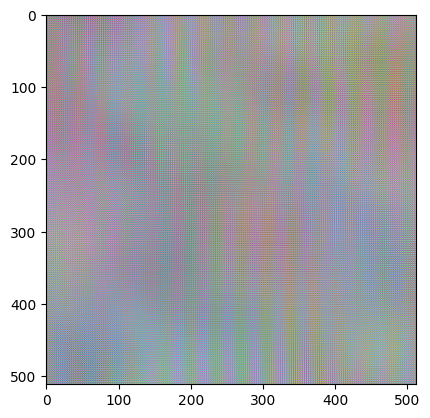

In [ ]:
for h in ([64,128,256,512]):
    for nh in [1,2,3,4,5]:
        cfg = load_cfg(overrides=[
            "+device=cuda:0",
            f'model.hidden_layers={nh}',
            f'model.hidden_features={h}'
        ])

        cfg.logging.experiment_name=get_experiment_name(cfg)

        # print(OmegaConf.to_yaml(cfg))
        train(cfg)

In [ ]:
! ls ../../data